**Importing Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
df= pd.read_csv('/content/drive/MyDrive/wine quality/winequality-red.csv',sep=';')

In [ ]:
df.head()

In [ ]:
df.isnull().any()

,0
fixed acidity,False
volatile acidity,False
citric acid,False
residual sugar,False
chlorides,False
free sulfur dioxide,False
total sulfur dioxide,False
density,False
pH,False
sulphates,False


In [ ]:
x=df.drop('quality',axis=1)

In [ ]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 11 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
dtypes: float64(11)
memory usage: 137.5 KB


### Removing Outliers by Z Score Method

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats

# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/wine quality/winequality-red.csv',sep=';')

# Function to remove outliers using Z-Score method
def remove_outliers_zscore(df, threshold=3):
    z_scores = np.abs(stats.zscore(df.select_dtypes(include=[np.number])))
    df = df[(z_scores < threshold).all(axis=1)]
    return df

# Removing outliers
df_clean_zscore = remove_outliers_zscore(df)

# Save cleaned data
df_clean_zscore.to_csv('cleaned_data_zscore.csv', index=False)

# Display results
print(f"Original data shape: {df.shape}")
print(f"Data shape after Z-Score removal: {df_clean_zscore.shape}")


Original data shape: (1599, 12)
Data shape after Z-Score removal: (1451, 12)


### Removing Outliers By IQR Methods

In [ ]:
import pandas as pd

# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/wine quality/winequality-red.csv',sep=';')

# Function to remove outliers using IQR method
def remove_outliers_iqr(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    df = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]
    return df

# Removing outliers
df_clean_iqr = remove_outliers_iqr(df)

# Save cleaned data
df_clean_iqr.to_csv('cleaned_data_iqr.csv', index=False)

# Display results
print(f"Original data shape: {df.shape}")
print(f"Data shape after IQR removal: {df_clean_iqr.shape}")


Original data shape: (1599, 12)
Data shape after IQR removal: (1179, 12)


### Visualizing the Outliers By Matplotlib And seaborn

Column names in the dataset:
Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality'],
      dtype='object')


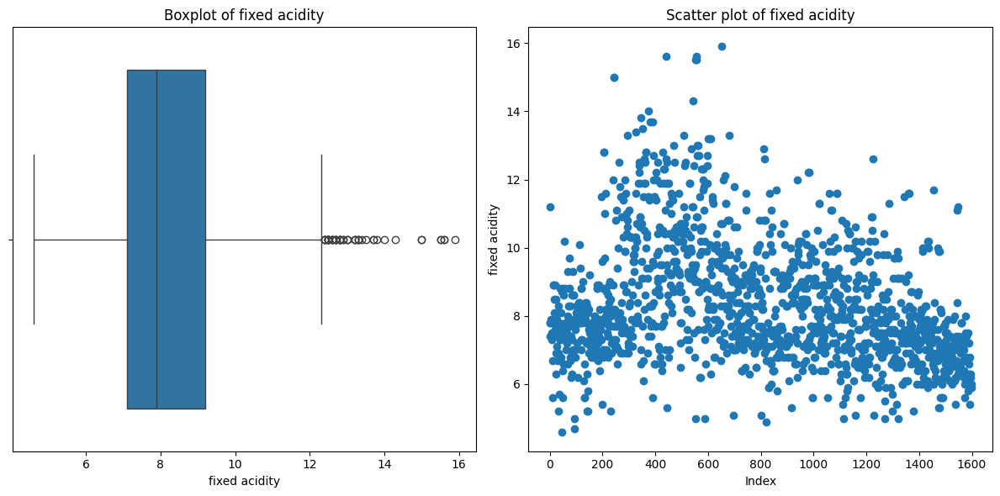

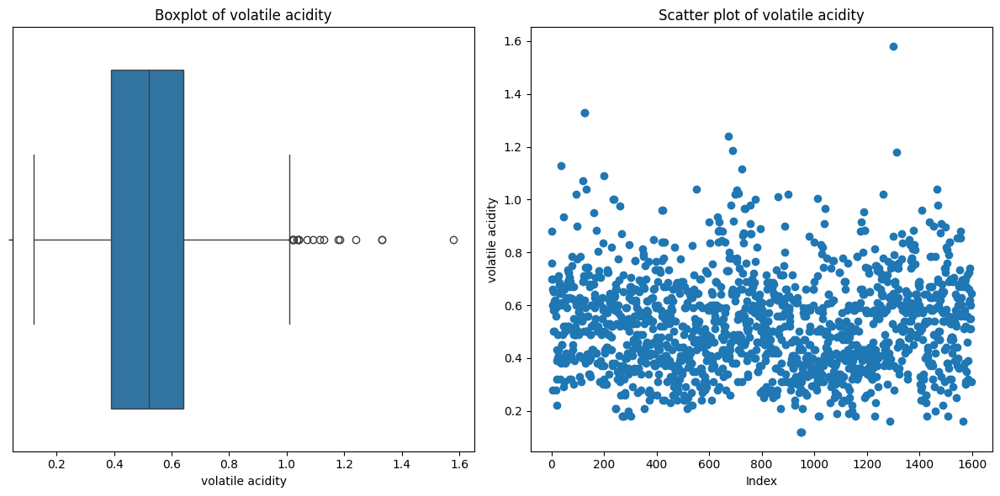

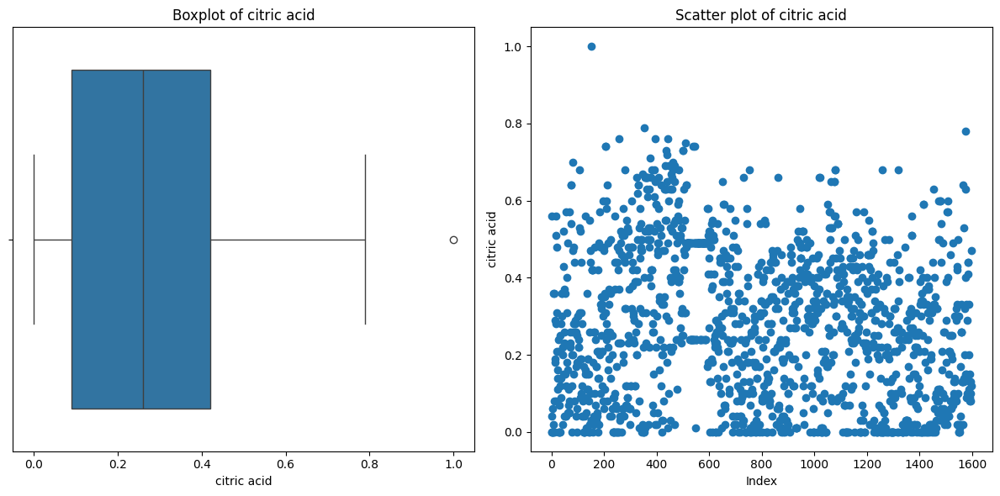

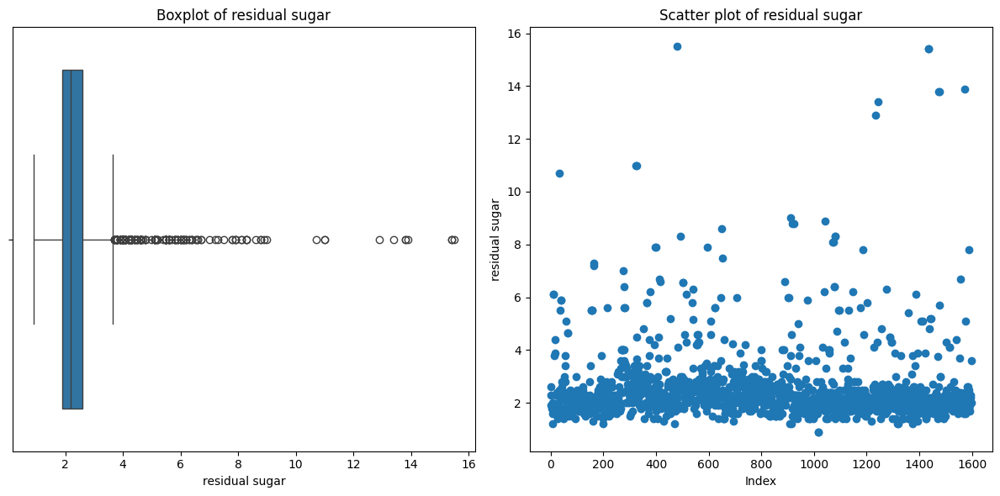

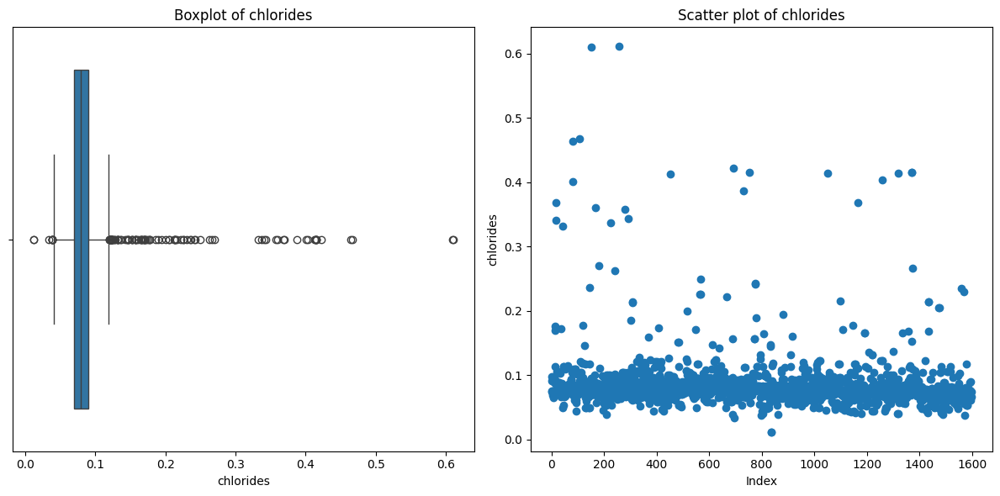

...

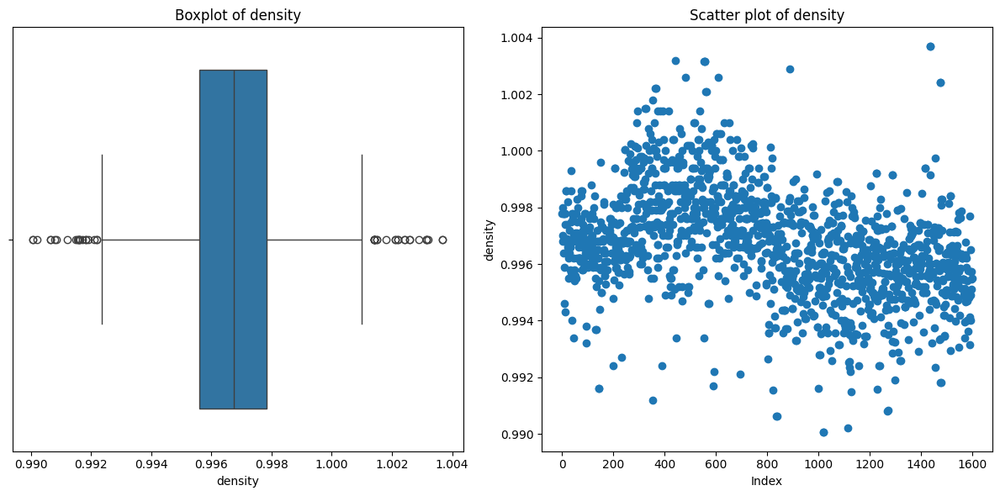

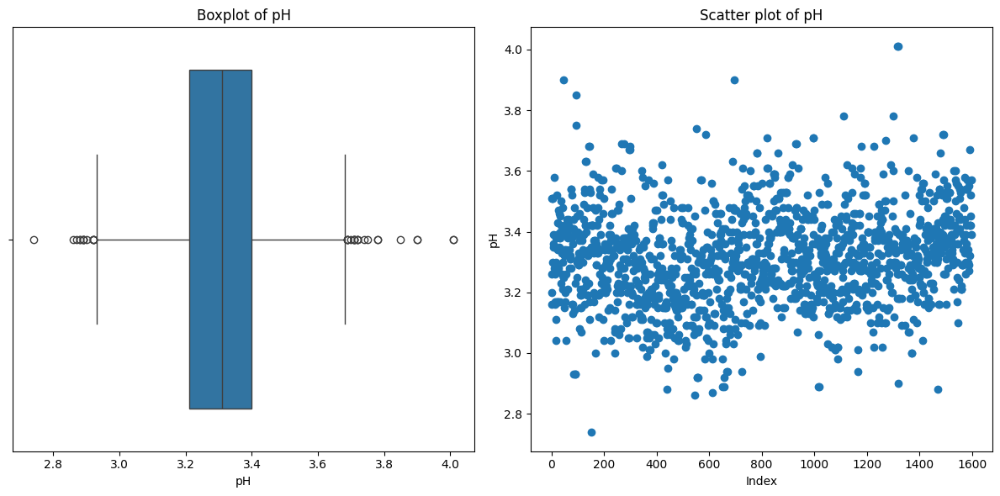

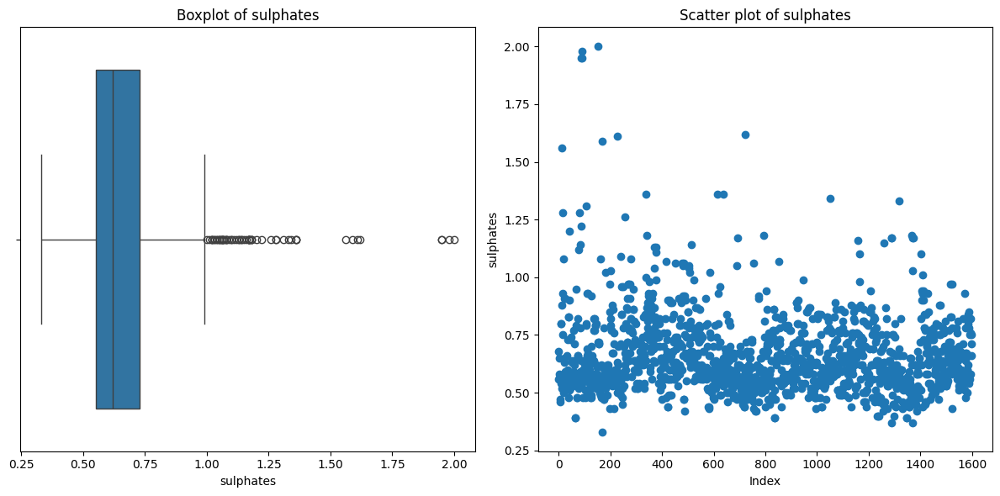

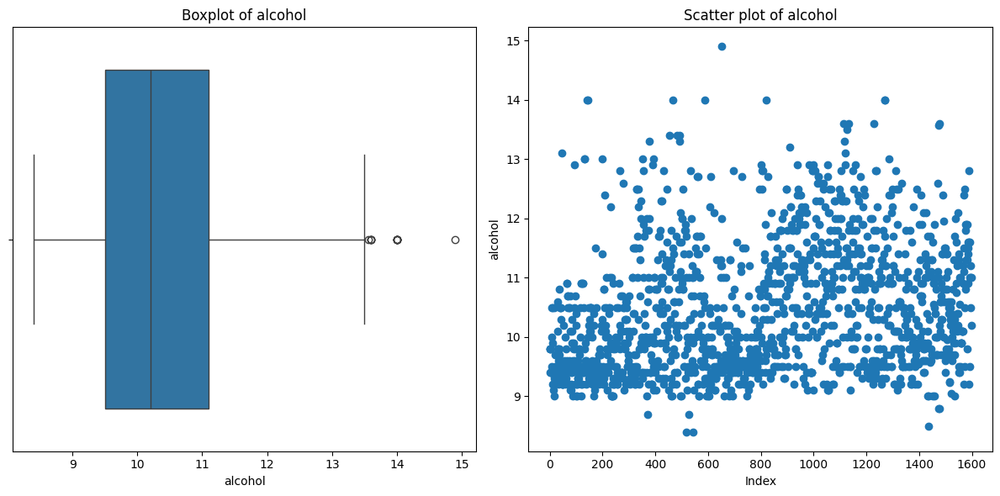

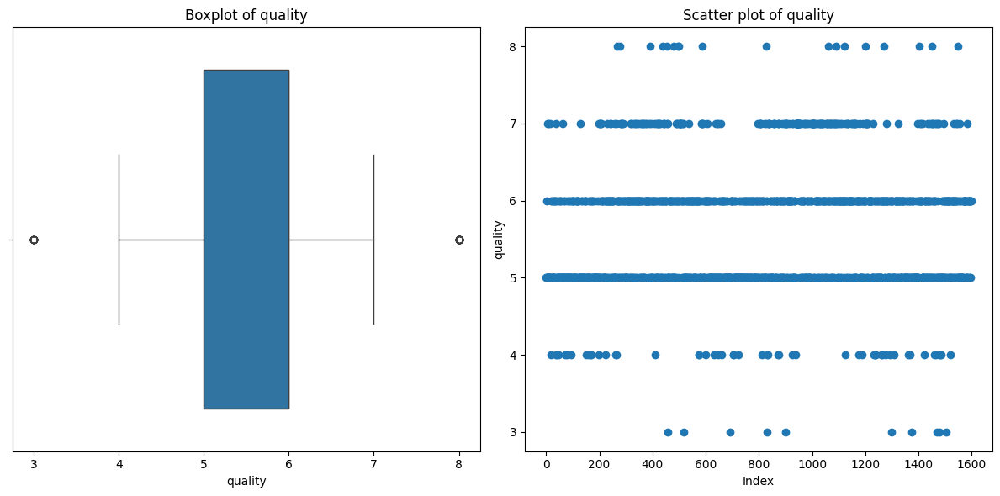

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/wine quality/winequality-red.csv',sep=';')

# Display the column names to ensure correct selection
print("Column names in the dataset:")
print(df.columns)

def visualize_outliers(df):
    numerical_columns = df.select_dtypes(include=[np.number]).columns
    for column in numerical_columns:
        plt.figure(figsize=(12, 6))

        # Boxplot
        plt.subplot(1, 2, 1)
        sns.boxplot(x=df[column])
        plt.title(f'Boxplot of {column}')

        # Scatter plot
        plt.subplot(1, 2, 2)
        plt.scatter(df.index, df[column])
        plt.title(f'Scatter plot of {column}')
        plt.xlabel('Index')
        plt.ylabel(column)

        plt.tight_layout()
        plt.show()

# Visualize outliers
visualize_outliers(df)


### Visualizig After Removing Outliers

Column names in the dataset:
Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality'],
      dtype='object')


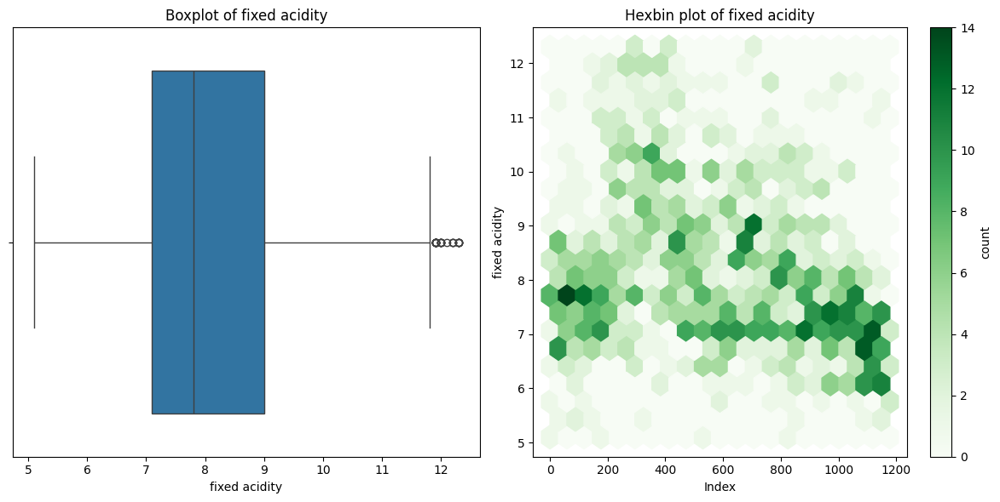

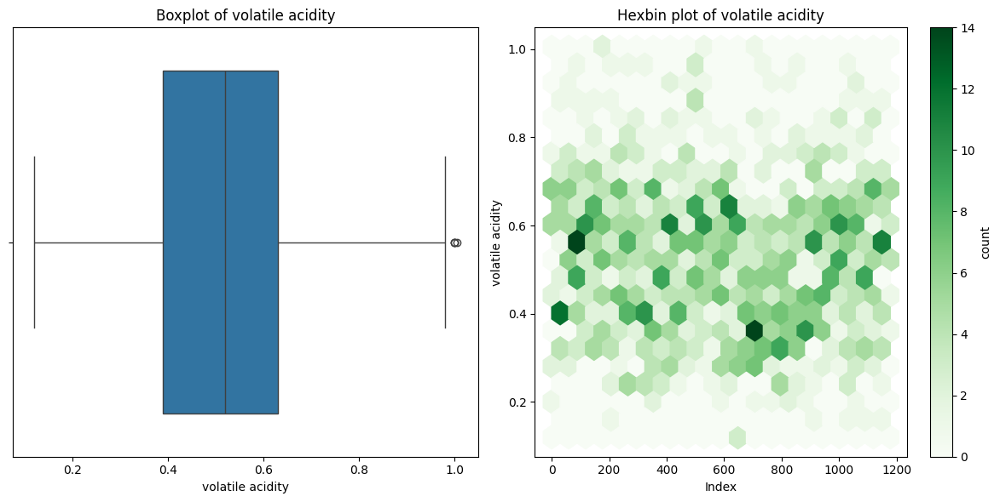

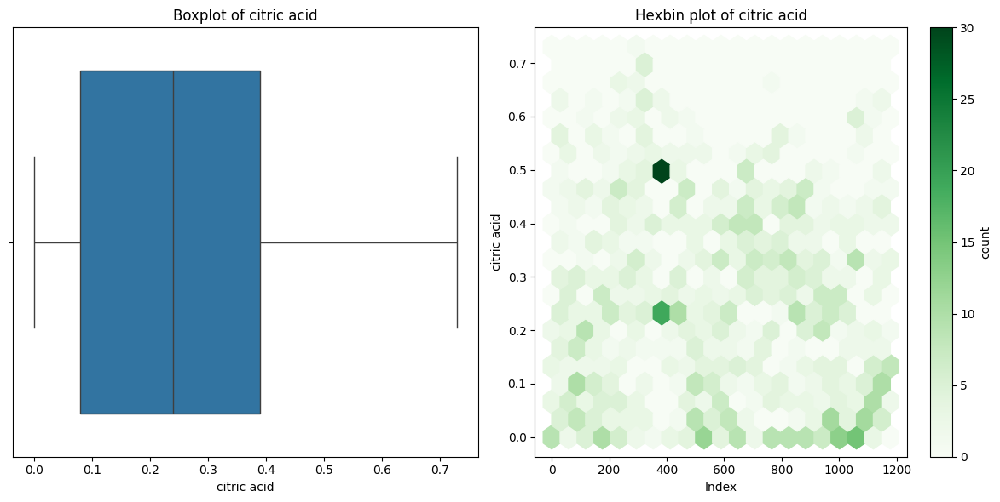

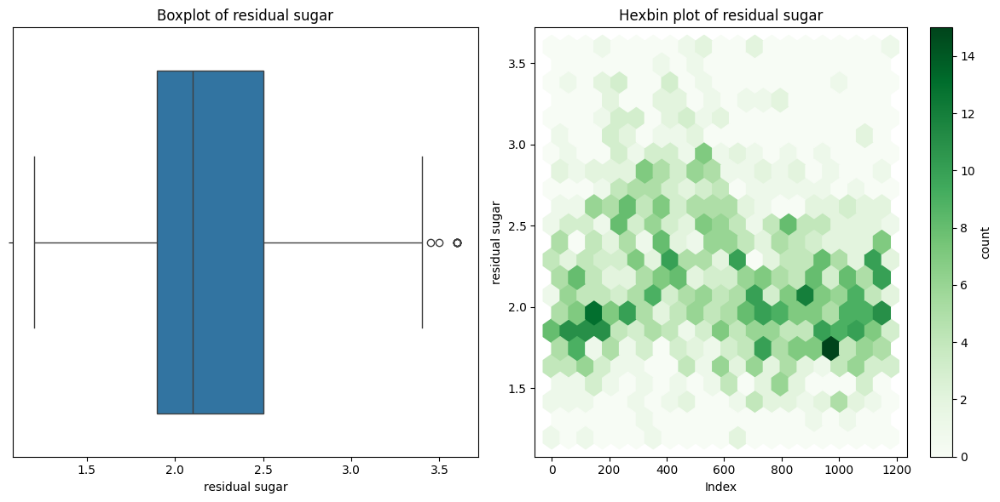

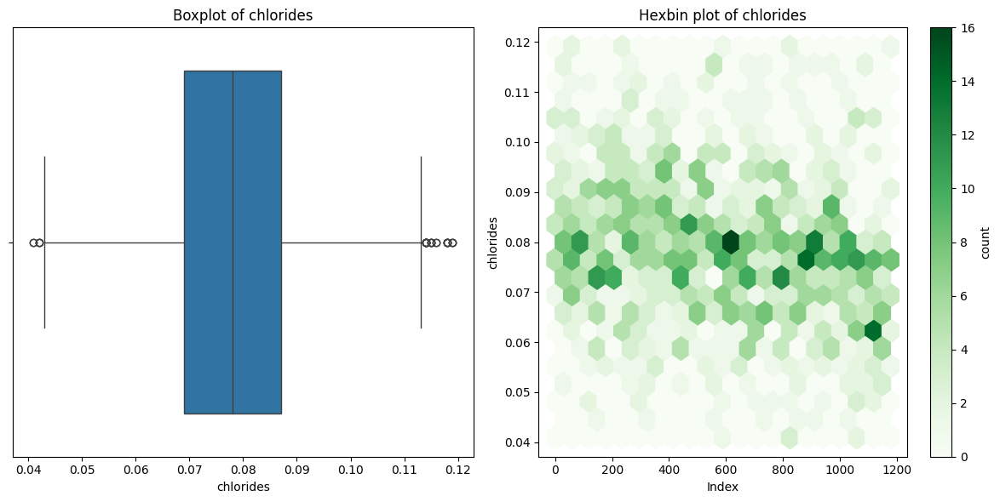

...

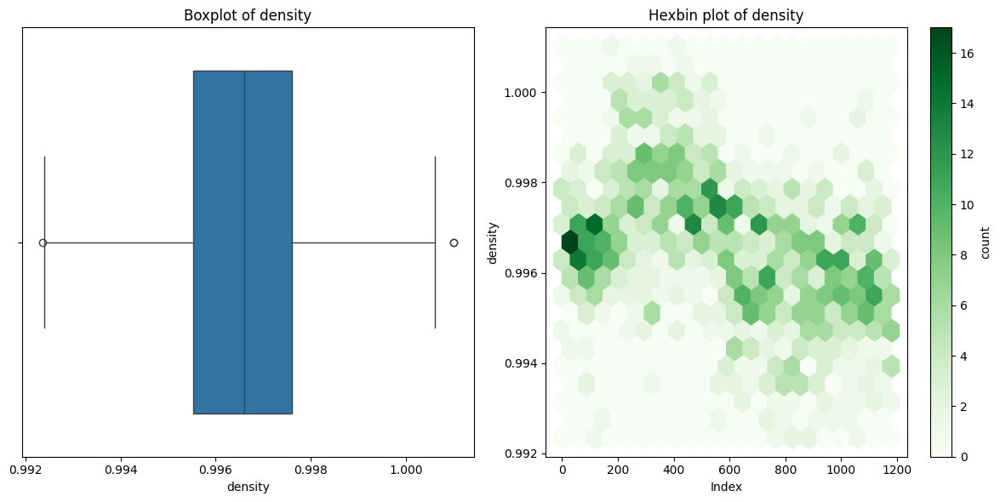

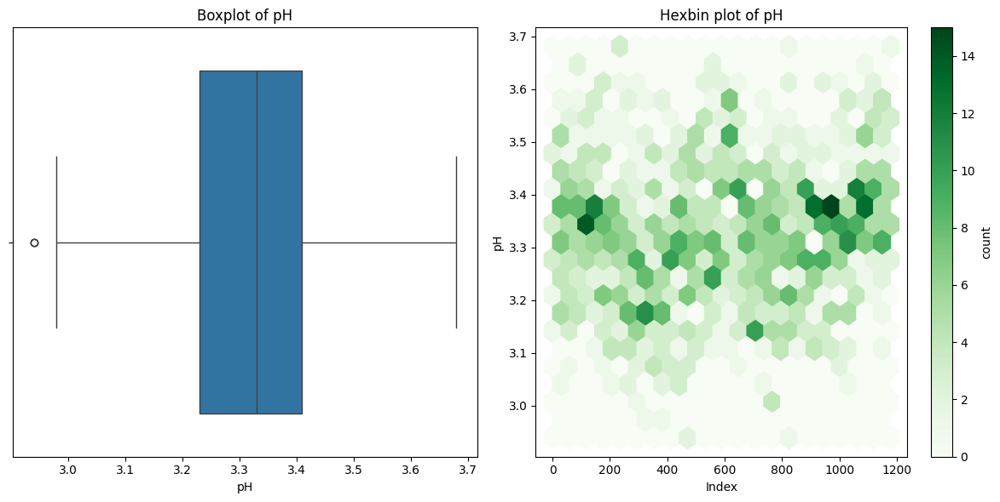

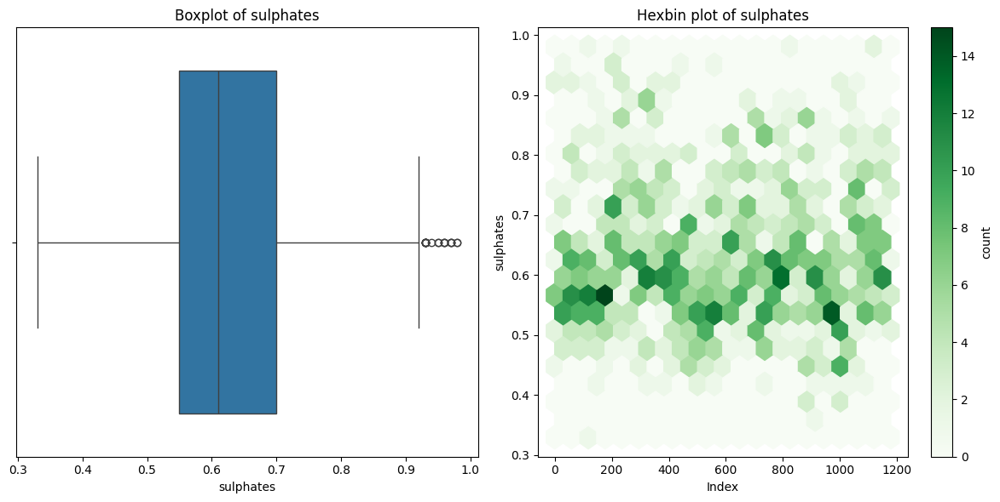

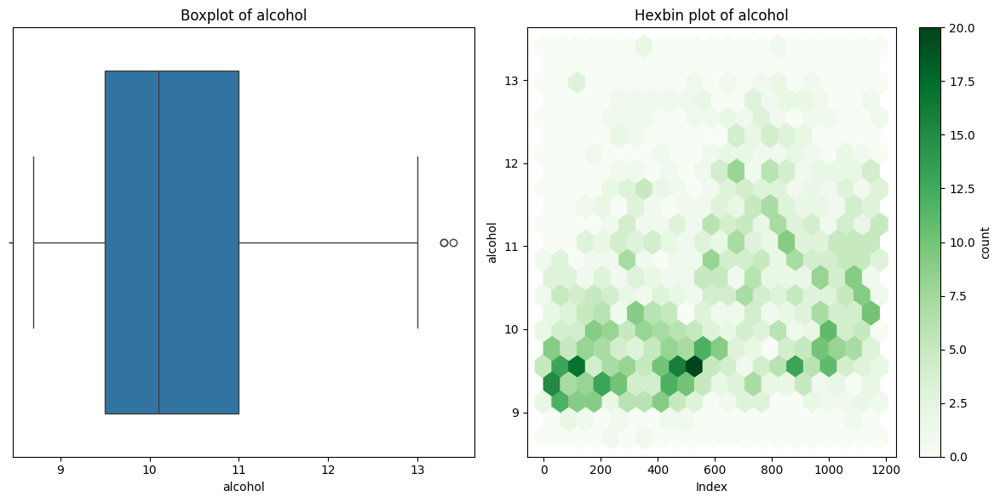

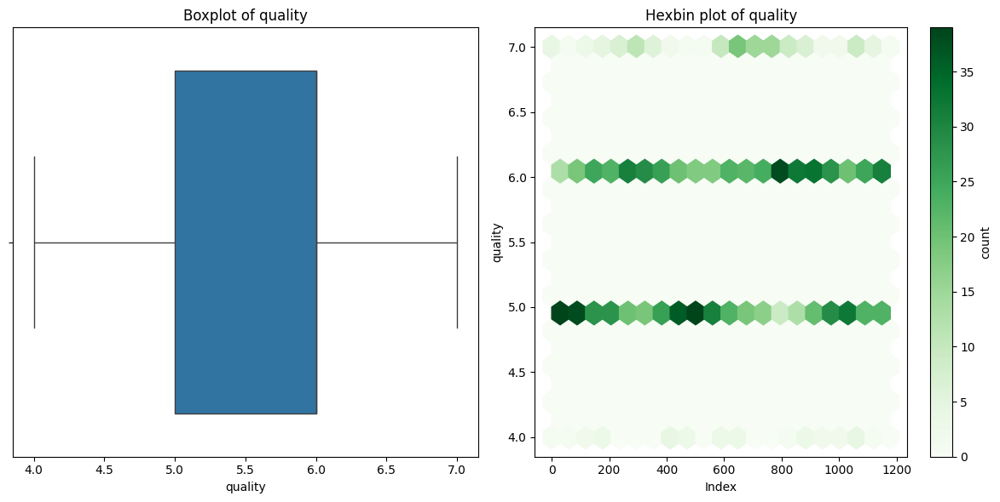

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset (assuming you have already loaded your dataset)
df = pd.read_csv('/content/cleaned_data_iqr.csv')

# Display the column names to ensure correct selection
print("Column names in the dataset:")
print(df.columns)

def visualize_outliers(df):
    numerical_columns = df.select_dtypes(include=[np.number]).columns
    for column in numerical_columns:
        plt.figure(figsize=(12, 6))

        # Boxplot
        plt.subplot(1, 2, 1)
        sns.boxplot(x=df[column])
        plt.title(f'Boxplot of {column}')

        # Hexbin plot in green color
        plt.subplot(1, 2, 2)
        plt.hexbin(df.index, df[column], gridsize=20, cmap='Greens')
        plt.title(f'Hexbin plot of {column}')
        plt.xlabel('Index')
        plt.ylabel(column)
        plt.colorbar(label='count')  # Add colorbar indicating count of points

        plt.tight_layout()
        plt.show()

# Visualize outliers
visualize_outliers(df)


Column names in the dataset:
Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality'],
      dtype='object')


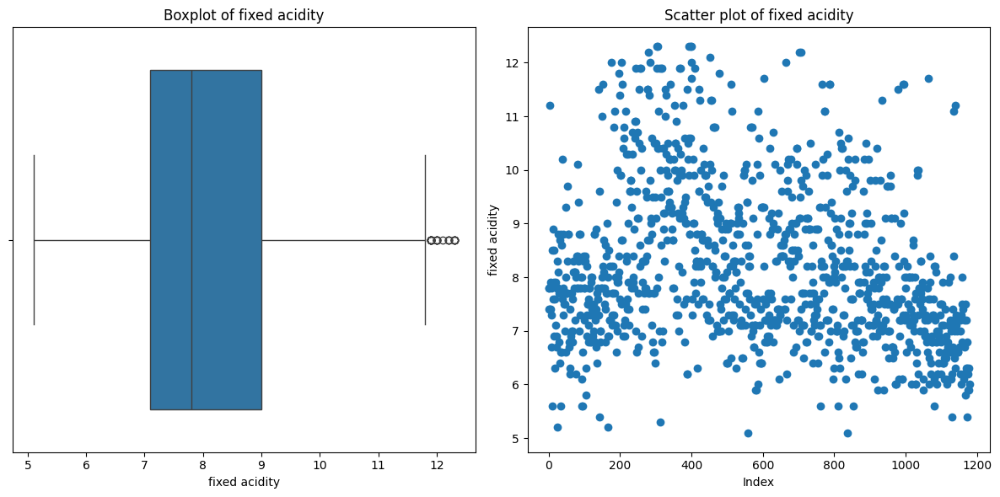

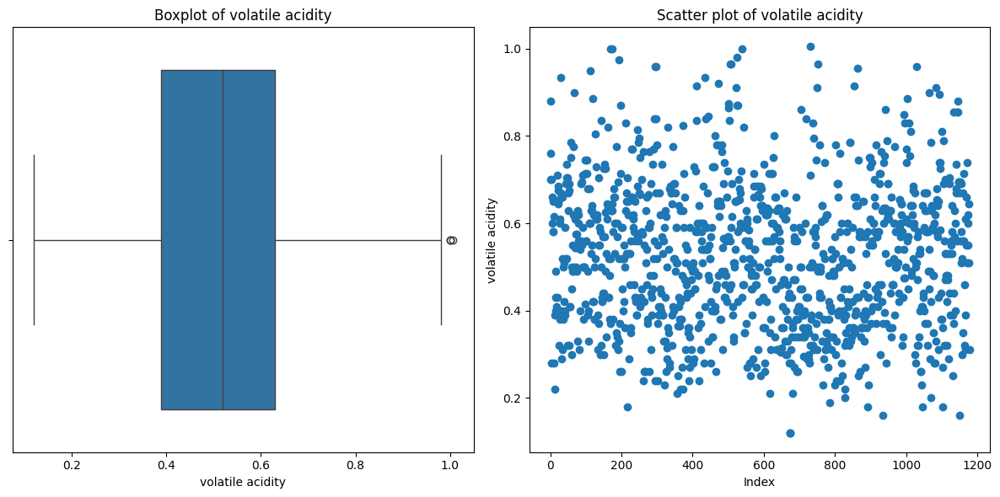

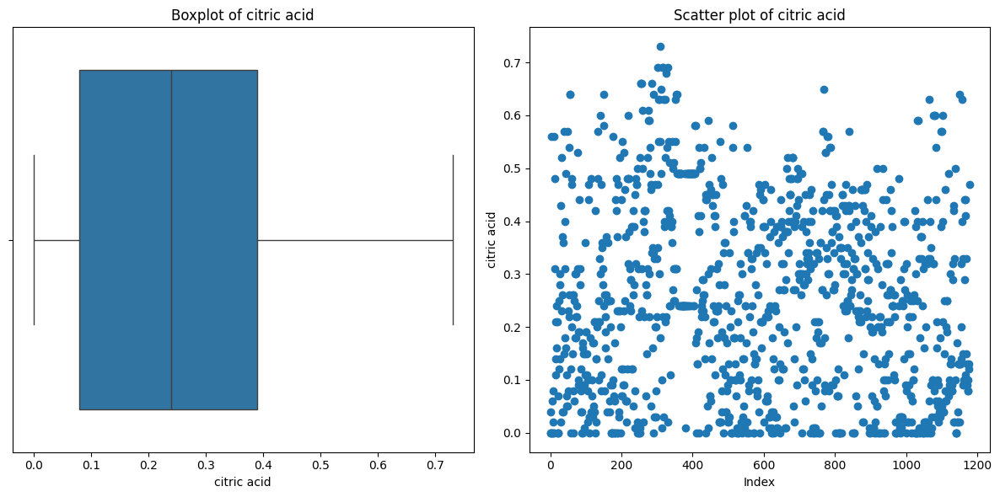

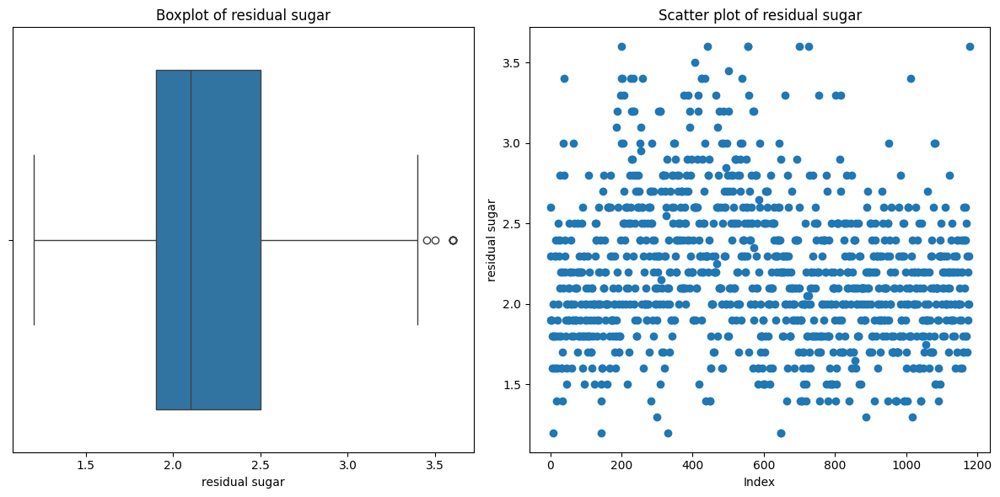

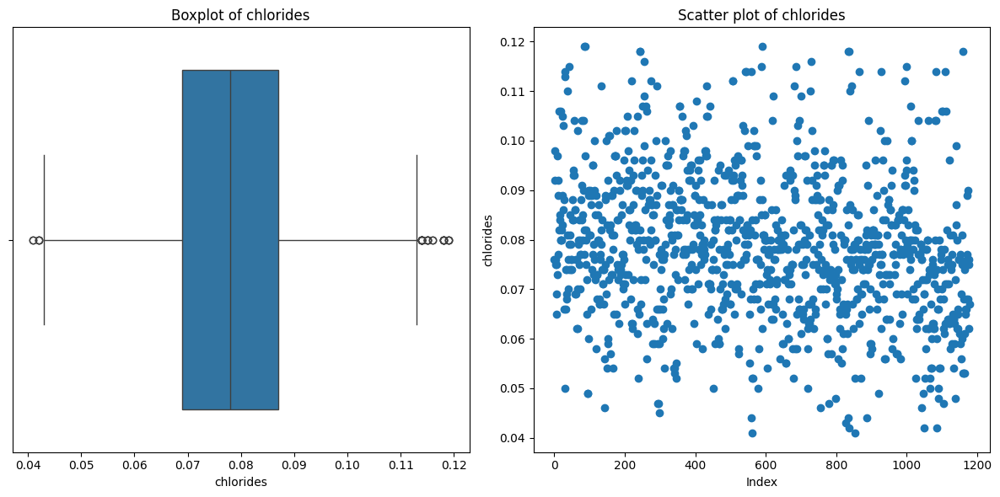

...

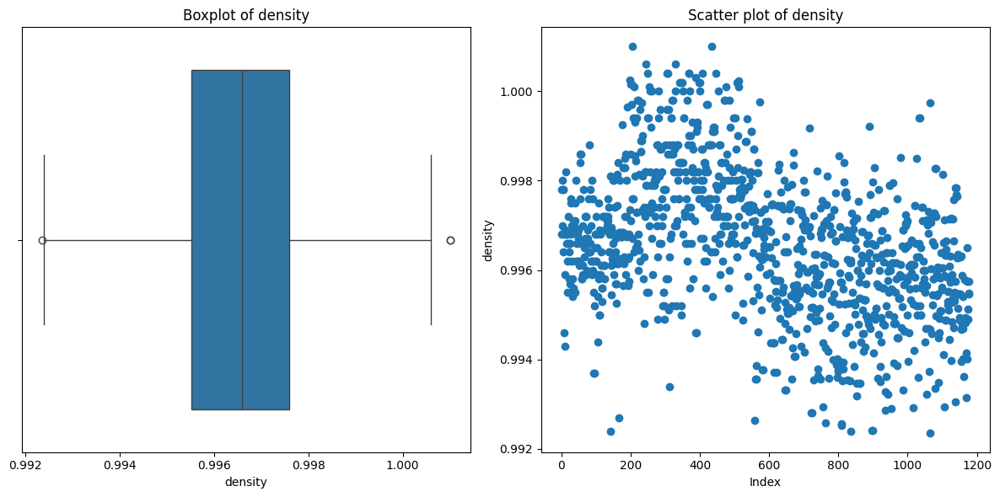

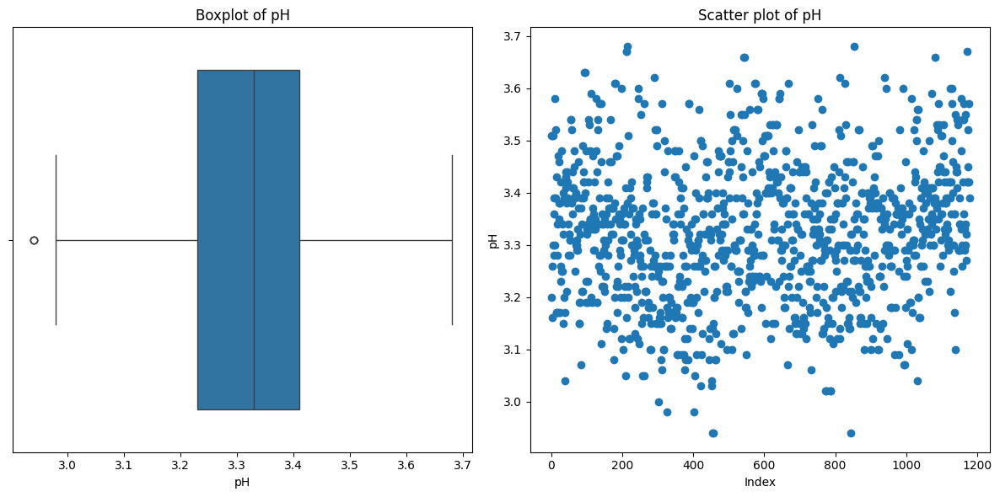

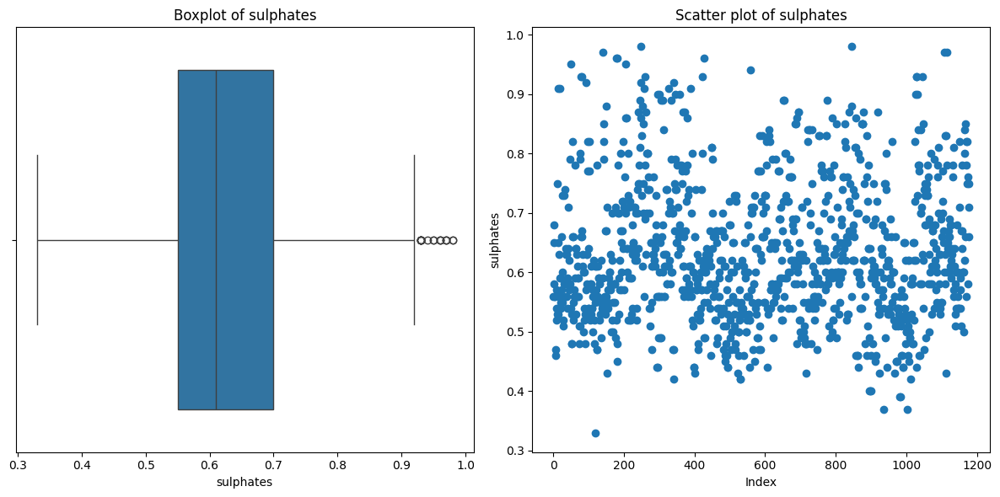

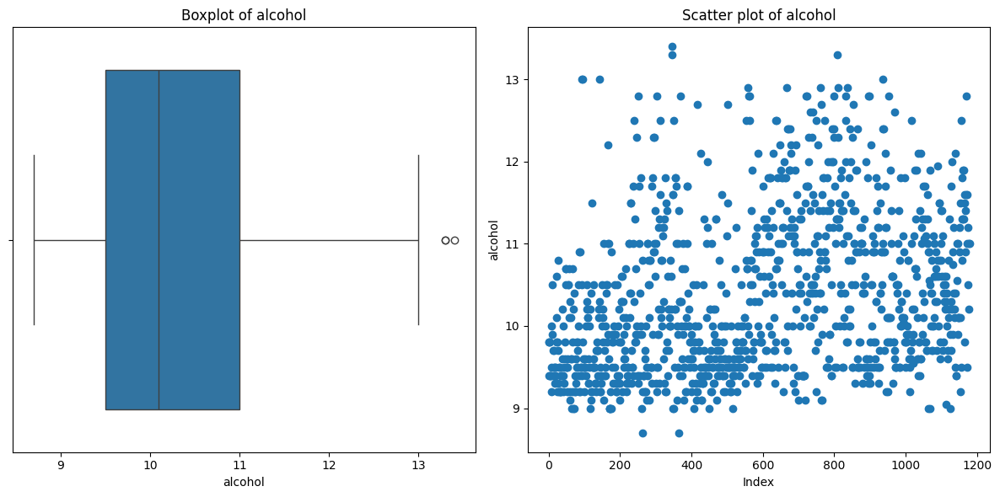

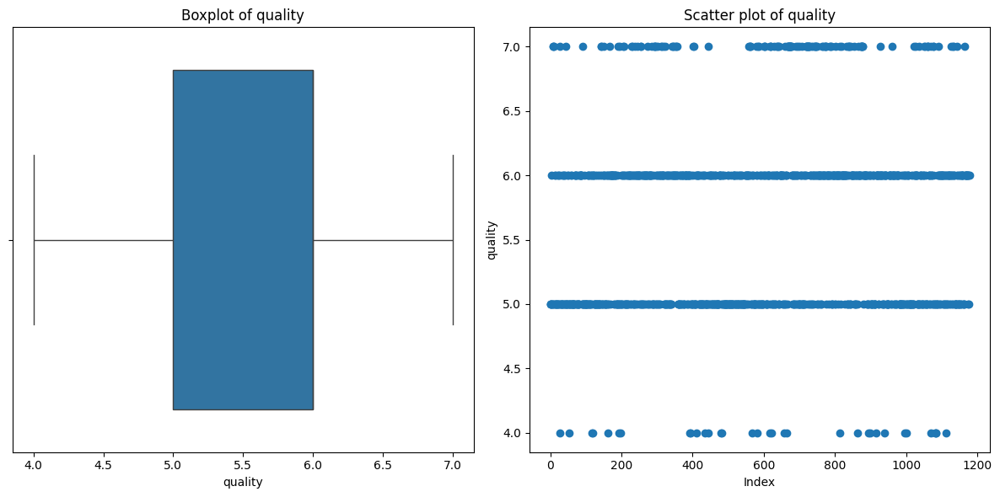

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
df = pd.read_csv('/content/cleaned_data_iqr.csv')

# Display the column names to ensure correct selection
print("Column names in the dataset:")
print(df.columns)

def visualize_outliers(df):
    numerical_columns = df.select_dtypes(include=[np.number]).columns
    for column in numerical_columns:
        plt.figure(figsize=(12, 6))

        # Boxplot
        plt.subplot(1, 2, 1)
        sns.boxplot(x=df[column])
        plt.title(f'Boxplot of {column}')

        # Scatter plot
        plt.subplot(1, 2, 2)
        plt.scatter(df.index, df[column])
        plt.title(f'Scatter plot of {column}')
        plt.xlabel('Index')
        plt.ylabel(column)

        plt.tight_layout()
        plt.show()

# Visualize outliers
visualize_outliers(df)



### Training the SVR and RandomForest Regressor

In [ ]:
# Importing necessary libraries
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error

df =pd.read_csv('/content/cleaned_data_zscore.csv')
X=df.drop('quality',axis=1)
y=df['quality']
# Assuming you have your data in a pandas DataFrame `X` (features) and `y` (target variable)

# Step 1: Splitting data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 2: Define models
# Random Forest Regressor
rf_regressor = RandomForestRegressor(random_state=42)

# Support Vector Regressor (SVR)
svr_regressor = SVR()

# Step 3: Define hyperparameters grid for GridSearchCV
# Random Forest hyperparameters
rf_param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# SVR hyperparameters
svr_param_grid = {
    'kernel': ['linear', 'rbf'],
    'C': [0.1, 1, 10],
    'epsilon': [0.01, 0.1, 0.2]
}

# Step 4: Perform GridSearchCV to find best hyperparameters for both models
rf_grid_search = GridSearchCV(estimator=rf_regressor, param_grid=rf_param_grid,
                              scoring='neg_mean_absolute_error', cv=5, verbose=2, n_jobs=-1)
rf_grid_search.fit(X_train, y_train)

svr_grid_search = GridSearchCV(estimator=svr_regressor, param_grid=svr_param_grid,
                               scoring='neg_mean_absolute_error', cv=5, verbose=2, n_jobs=-1)
svr_grid_search.fit(X_train, y_train)

# Best hyperparameters
print("Best Random Forest Regressor hyperparameters:", rf_grid_search.best_params_)
print("Best SVR hyperparameters:", svr_grid_search.best_params_)

# Step 5: Evaluate models on training and test sets using MAE
def evaluate_model(model, X_train, X_test, y_train, y_test):
    # Training set evaluation
    y_train_pred = model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_train_pred)

    # Test set evaluation
    y_test_pred = model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_test_pred)

    return mae_train, mae_test

# Evaluate Random Forest Regressor
rf_best_model = rf_grid_search.best_estimator_
rf_mae_train, rf_mae_test = evaluate_model(rf_best_model, X_train, X_test, y_train, y_test)
print("Random Forest Regressor MAE - Train:", rf_mae_train)
print("Random Forest Regressor MAE - Test:", rf_mae_test)

# Evaluate SVR
svr_best_model = svr_grid_search.best_estimator_
svr_mae_train, svr_mae_test = evaluate_model(svr_best_model, X_train, X_test, y_train, y_test)
print("SVR MAE - Train:", svr_mae_train)
print("SVR MAE - Test:", svr_mae_test)

# Compute MASE
def compute_mase(mae_model, mae_baseline, y_true):
    return np.mean(np.abs(y_true - mae_model)) / np.mean(np.abs(y_true - mae_baseline))

rf_mase_train = compute_mase(rf_mae_train, baseline_mae_train, y_train)
rf_mase_test = compute_mase(rf_mae_test, baseline_mae_test, y_test)
print("Random Forest Regressor MASE - Train:", rf_mase_train)
print("Random Forest Regressor MASE - Test:", rf_mase_test)

svr_mase_train = compute_mase(svr_mae_train, baseline_mae_train, y_train)
svr_mase_test = compute_mase(svr_mae_test, baseline_mae_test, y_test)
print("SVR MASE - Train:", svr_mase_train)
print("SVR MASE - Test:", svr_mase_test)


Fitting 5 folds for each of 108 candidates, totalling 540 fits
Fitting 5 folds for each of 18 candidates, totalling 90 fits
Best Random Forest Regressor hyperparameters: {'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best SVR hyperparameters: {'C': 1, 'epsilon': 0.1, 'kernel': 'linear'}
Random Forest Regressor MAE - Train: 0.14799657782939532
Random Forest Regressor MAE - Test: 0.4421639211227866
SVR MAE - Train: 0.4717315847653028
SVR MAE - Test: 0.5071714137935216
Random Forest Regressor MASE - Train: 1.1152800226462816
Random Forest Regressor MASE - Test: 1.0630357982925813
SVR MASE - Train: 1.0497191623031163
SVR MASE - Test: 1.0498346954543512


Tree 1:


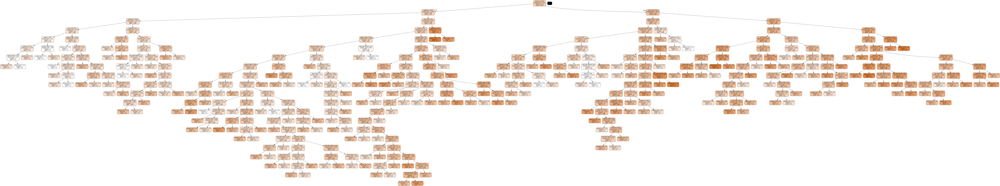

Tree 2:


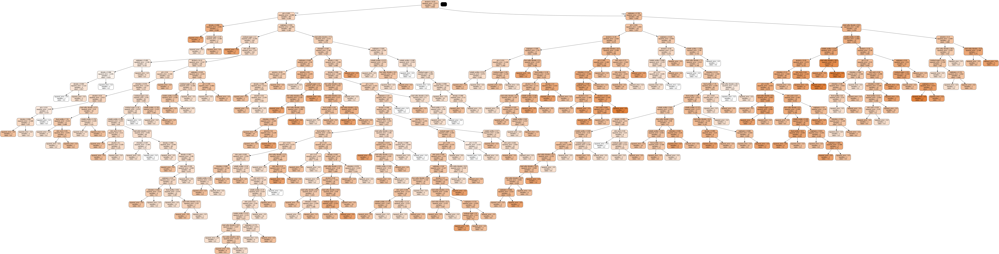

Tree 3:


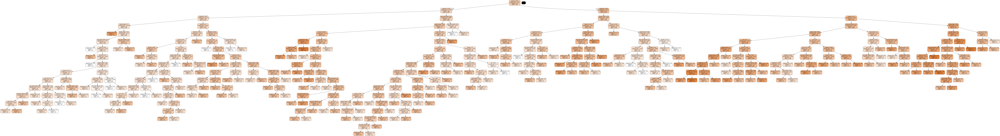

Tree 4:


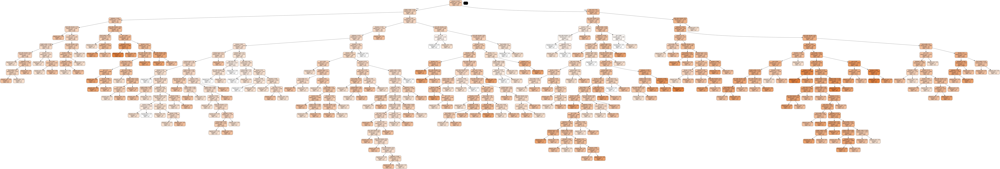

In [ ]:
# Importing necessary libraries
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import export_graphviz
from IPython.display import Image
import pydotplus

df =pd.read_csv('/content/cleaned_data_zscore.csv')
X=df.drop('quality',axis=1)
y=df['quality']
# Assuming you have your data in a pandas DataFrame `X` (features) and `y` (target variable)

# Step 1: Splitting data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 2: Define a Random Forest Regressor model
rf_regressor = RandomForestRegressor(random_state=42)

# Step 3: Train the model
rf_regressor.fit(X_train, y_train)

# Step 4: Visualizing the best 4 trees from the Random Forest
def visualize_tree(tree, feature_names, i):
    # Export the i-th tree to a dot file
    dot_data = export_graphviz(tree, out_file=None,
                               filled=True, rounded=True,
                               special_characters=True, feature_names=feature_names)
    graph = pydotplus.graph_from_dot_data(dot_data)

    # Show the tree using matplotlib and Image libraries
    print(f"Tree {i+1}:")
    return Image(graph.create_png())

# Get feature names from X
feature_names = X.columns

# Get indices of the 4 best trees
best_tree_indices = np.argsort(rf_regressor.feature_importances_)[-4:]

# Visualize the best 4 trees
for i, tree_idx in enumerate(best_tree_indices):
    tree = rf_regressor.estimators_[tree_idx]
    tree_image = visualize_tree(tree, feature_names, i)
    display(tree_image)
